# Week 4 - Exploring Semantic Spaces (Word Embeddings)
This week, we build on last week's topic modeling techniques by taking a text corpus we have developed, specifying an underlying number of dimensions, and training a model with a neural network auto-encoder (one of Google's word2vec  algorithms) that best describes corpus words in their local linguistic contexts, and exploring their locations in the resulting space to learn about the discursive culture that produced them.

This is our third document representation we have learned: First, we used word counts. Second, we used LDA topic models built around term coocurrence in the same document (i.e., a "bag of words"). Third, documents here are represented as densely indexed locations in dimensions, so that distances between those documents (and words) contain more information, though they require the full vector of dimension loadings (rather than just a few selected topic loadings) to describe. We will explore these spaces to understand complex, semantic relationships between words, index documents with descriptive words, identify the likelihood that a given document would have been produced by a given vector model, and explore how semantic categories can help us understand the cultures that produced them.

Note that most modern natural language processing (NLP) research, at least in computer science, uses word embeddings. This is the foundation of most state-of-the-art models.

Also note that the code in this Notebook can take many minutes or even hours to run. This is the case for most NLP research these days, and it's a good opportunity to start thinking about how to manage high-compute workloads, such as running code on small samples to test it, loading datafiles in [chunks](https://stackoverflow.com/a/25962187), or [multiprocessing](https://en.wikipedia.org/wiki/Multiprocessing).

## <font color="red">*Pitch Your Project*</font>

<font color="red">In the three cells immediately following, describe **WHAT** you are planning to analyze for your final project (i.e., texts, contexts and the social game, world and actors you intend to learn about through your analysis) (<200 words), **WHY** you are going to do it (i.e., why would theory and/or the average person benefit from knowing the results of your investigation) (<200 words), and **HOW** you plan to investigate it (i.e., what are the approaches and operations you plan to perform, in sequence, to yield this insight) (<400 words).

# ***What?***
<200 words

## ***Why?***
<200 words

## ***How?***
<400 words

## <font color="red">*Pitch Your Sample*</font>

<font color="red">In the cell immediately following, describe the rationale behind your proposed sample design for your final project. What is the social game, social work, or social actors you about whom you are seeking to make inferences? What are its virtues with respect to your research questions? What are its limitations? What are alternatives? What would be a reasonable path to "scale up" your sample for further analysis (i.e., high-profile publication) beyond this class? (<300 words).

## ***Which (words)?***
<300 words

**What?**

For my final project, I intend to analyze posts and threads on 4chan's /lgbt/ board. Specifically, my documents will be the threads themselves, with sentences and words in the posts as my tokens. My overarching goal is understanding the conceptions of transness held by trans people on 4chan, with the hope of comparing those to the conceptions of transness held by other communities. However, as as /lgbt/ seems to be relatively understudied, my first goal (and what will likely comprise the majority of my project for this class) is to understand who is using /lgbt/ and how they are doing it. That is, what groups are on the board? How prominent are the voices of these groups? What interactions do the groups have? And so on.

**Why?**

The mixture of queer -- and particularly trans -- people and 4chan provide an interesting mix of theoretical consideration. Trans people on the site seem to be engaging in identity building practices documented from other websites, such as Susan's Place and Tumblr. However, the site itself lacks many of traditional identity construction affordances, such as profile creation and friending, attributed by boyd to more traditional social network sites. In fact, 4chan itself is largely constructed with the goal of protecting anonymity, which would seem to be in direct conflict with identity creation on the site. It's thus expected that forms of identity creation seen on 4chan will differ from those documented elsewhere in literature, in ways that could have impacts on (applied) trans studies and communication studies.

**How?**

I'm planning to make use of a (limited) version of the Computational Grounded Theory approach described by Nelson (2021). My primary analysis will focus on document embeddings of 4chan threads using the doc2vec DBOW model, which will let me cluster 4chan threads in document space to investigate what types of discussion are occurring on 4chan semantically. Then, I can characterize these clusters through close reading of representative members and through analysis of what words are nearest the document centroids. 

That initial analysis should give rise to new hypotheses. Depending on time constraints, I can either limit my discussion to one of "what is happening on /lgbt/ over <xyz> time", or I can pull in a second week's worth of data to do verification analyses on, with the specific methods chosen guided by the hypotheses created.

Heading into this analysis, I have a few different expectations as to how 4chan is being used, such as:
1. Users will often use the space as to get support for self-improvement and for advice on transitioning, with this usage being juxtaposed by denigration of queer people. 
2. 4chan is a relative hotbed for incels, so I anticipate finding ideological conflict between inceldom and otherwise lgbt ideas.
3. Identity creation on the site will likely be transient, with much of the work of identity construction being done explicitly in a post (e.g. by saying "I'm <xyz>")

To further characterize the site, I hope to investigate a few broader level summary statistics about /lgbt/'s usage, such as determining the site's peak posting hours, estimating the average life of a post, and comparing the number of users with tripcodes to those without tripcodes.

**Which?**

My research questions focus on the usage of the /lgbt/ board on 4chan, which makes sampling the posts -- the direct evidence of how users are using the board -- a strong sample, and one well positioned to address my research question. However, this sample faces multiple limitations. In particular, I can only hope to sample at most a week's worth of data, and (as my script only scrapes the website on occassion, instead of continuously refreshing) I cannot guarantee the completeness of my sample. It's also not clear that the activity of 4chan on any given week is fully generalizable across time, as the community on the website is itself evolving. 

An alternative data source that sidesteps both of these issues would be to pull data from [archived.moe](archived.moe). However, as the site is ran by a mysterious third party, I would need to verify the completeness and accuracy of the data on the website by collecting my own sample to compare against that from archived.moe. 

In any case, this project should result in a sample that can be scaled up in the future: I'll be able to just let my script run for longer -- collecting additional data -- or I'll be able to verify the accuracy of archived.moe -- allowing me to scrape historical posts -- or possibly both, allowing for an even nicer sample.

In [ ]:
!pip install -U git+https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git

  Cloning https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git to c:\users\wimer\appdata\local\temp\pip-req-build-to9ddhdy
  Resolved https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git to commit b17a265d3b8253424e5b38872457f7437909a65d
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'


  Running command git clone --filter=blob:none --quiet https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git 'C:\Users\wimer\AppData\Local\Temp\pip-req-build-to9ddhdy'


In [37]:
#All these packages need to be installed from pip
import gensim #For word2vec, etc
import requests #For downloading our datasets
import lucem_illud #pip install -U git+https://github.com/UChicago-Computational-Content-Analysis/lucem_illud.git

import numpy as np #For arrays
import pandas as pd #Gives us DataFrames
import matplotlib.pyplot as plt #For graphics
import seaborn #Makes the graphics look nicer
import sklearn.metrics.pairwise #For cosine similarity
import sklearn.manifold #For T-SNE
import sklearn.decomposition #For PCA

#This 'magic' command makes the plots work better
#in the notebook, don't use it outside of a notebook.
#Also you can ignore the warning
%matplotlib inline

import os #For looking through files
import os.path #For managing file paths

import copy

# This is my new favorite thing when working with large
# datasets.
from tqdm import tqdm
tqdm.pandas()

## <font color="red">*Exercise 1*</font>

<font color="red">Construct cells immediately below this that embed documents related to your final project using at least two different specification of `word2vec` and/or `fasttext`, and visualize them each with two separate visualization layout specifications (e.g., TSNE, PCA). Then interrogate critical word vectors within your corpus in terms of the most similar words, analogies, and other additions and subtractions that reveal the structure of similarity and difference within your semantic space. What does this pattern reveal about the semantic organization of words in your corpora? Which estimation and visualization specification generate the most insight and appear the most robustly supported and why?

<font color="red">***Stretch***: Explore different vector calculations beyond addition and subtraction, such as multiplication, division or some other function. What does this exploration reveal about the semantic structure of your corpus?

### Getting my corpora

I've been largely avoiding my 4chan data due to the difficulties inherent in cleaning, collecting, and working with said data. But at this point I have a _lot_ of 4chan posts, so I'm going to actually load in the dataset as it currently exists and work with it for this analysis.

As a quick rundown as to what this corpus _is_ -- eessentially, it contains posts on 4chan's /lgbt/ board made over the past few weeks. It doesn't contain all such posts, as posts were only collected whenever I actually remembered to check for posts being created. But it should have some interesting information nonetheless, and much of the code below can be reused or repurposed as I continue cleaning and constructing this dataset more meticulously. 

In [2]:
chan = pd.read_csv('../data/lgbt_tokenized.csv')
print(chan.shape)
chan.head()

(60765, 9)


,subject,id,author,time,content,clean_content,tokens,refs,urls
0,lesgen is disgusting,34346616,Anonymous,01/21/24(Sun)06:32:18 No.34346616,>go on lesgen>expecting it to be bad but had n...,>go on lesgen>expecting it to be bad but had n...,"[>, go, on, lesgen, >, expecting, it, to, be, ...",[],[]
1,lesgen is disgusting,34346631,Anonymous,01/21/24(Sun)06:35:09 No.34346631,>>34346616They include transbians tooWhat you ...,\nThey include transbians tooWhat you expect?,"[They, include, transbians, tooWhat, you, expect]",['>>34346616'],[]
2,lesgen is disgusting,34346636,Anonymous,01/21/24(Sun)06:35:41 No.34346636,>>34346616>goes to lesgen right now>ctrl + f d...,"\n>goes to lesgen right now>ctrl + f diaper, l...","[>, goes, to, lesgen, right, now, >, ctrl, +, ...",['>>34346616'],[]
3,lesgen is disgusting,34346654,Anonymous,01/21/24(Sun)06:37:51 No.34346654,>>34346636i meant the discord,\ni meant the discord,"[i, meant, the, discord]",['>>34346636'],[]
4,lesgen is disgusting,34346667,Anonymous,01/21/24(Sun)06:39:55 No.34346667,>>34346654I was in the wlwgen discord whenever...,\nI was in the wlwgen discord whenever that wa...,"[I, was, in, the, wlwgen, discord, whenever, t...",['>>34346654'],[]


I _do_ have a tokenizer that runs when I pull posts, but I haven't had a good chance to inspect it's performance prior to now. It appears that `>` did not get considered as punctuation, meaning the tokenizer is performing a bit less well than I would otherwise like. Similarly, some words seem to get combined ("tooWhat"), although given that this is occuring in the `content` column -- which has no preprocessing applied -- that is likely just a typo in the original post. 

In [3]:
from tqdm import tqdm
tqdm.pandas()

def cleaner_tokens(soiled_tokens):
    '''
    Cleans up a few messes in my tokens.

    Inputs:
      soiled_tokens (list of strings): the dirty tokens

    Returns: list of tokens without any punctuation.
    '''
    rv = []
    for value in soiled_tokens:
        if value not in ['<', '+', '>', ':', ';', '=', '/', '\\']:
            rv.append(value)
    return rv

# I'm actually not entirely sure the lucem_illud function for this will do
# a great job, but I may as well go for it
chan['tokenized_sents'] = chan['clean_content']\
                            .progress_apply(lambda x: [cleaner_tokens(lucem_illud.word_tokenize(s)) for s in lucem_illud.sent_tokenize(str(x))])

chan['normalized_sents'] = chan['tokenized_sents']\
                            .progress_apply(lambda x: [lucem_illud.normalizeTokens(s, lemma=False) for s in x])

chan.to_csv('../data/4chan_with_sents.csv')

chan[:100:10]

  0%|          | 0/60765 [00:00<?, ?it/s]C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
100%|██████████| 60765/60765 [04:59<00:00, 203.02it/s]


,subject,id,author,time,content,clean_content,tokens,refs,urls,tokenized_sents,normalized_sents
0,lesgen is disgusting,34346616,Anonymous,01/21/24(Sun)06:32:18 No.34346616,>go on lesgen>expecting it to be bad but had n...,>go on lesgen>expecting it to be bad but had n...,"[>, go, on, lesgen, >, expecting, it, to, be, ...",[],[],"[[go, on, lesgen, expecting, it, to, be, bad, ...","[[lesgen, expecting, bad, clue, depraved, was>..."
10,34349511,34349511,Anonymous,01/21/24(Sun)12:32:56 No.34349511,>try to think deeply about whether or not I'd ...,>try to think deeply about whether or not I'd ...,"[>, try, to, think, deeply, about, whether, or...",[],[],"[[try, to, think, deeply, about, whether, or, ...","[[try, think, deeply, like, effects, testoster..."
20,mmg momiji manmoder manmodder (...),34342635,Anonymous,01/20/24(Sat)21:48:27 No.34342635,>>34342610>answering my own qotta KNIFE I'll f...,\n>answering my own qotta KNIFE I'll fucking C...,"[>, answering, my, own, qotta, KNIFE, I, 'll, ...",['>>34342610'],[],"[[answering, my, own, qotta, KNIFE], [I, 'll, ...","[[answering, qotta, knife], [fucking, cut]]"
30,mmg momiji manmoder manmodder (...),34343486,Anonymous,01/20/24(Sat)23:19:38 No.34343486,>>34343372I plan on a maple leaf tattoo of som...,\nI plan on a maple leaf tattoo of some kind a...,"[I, plan, on, a, maple, leaf, tattoo, of, some...",['>>34343372'],[],"[[I, plan, on, a, maple, leaf, tattoo, of, som...","[[plan, maple, leaf, tattoo, kind, point]]"
40,mmg momiji manmoder manmodder (...),34343822,Anonymous,01/20/24(Sat)23:52:11 No.34343822,>>34343794>never passerI sense a hyper fem boy...,\n>never passerI sense a hyper fem boymoder,"[>, never, passerI, sense, a, hyper, fem, boym...",['>>34343794'],[],"[[never, passerI, sense, a, hyper, fem, boymod...","[[passeri, sense, hyper, fem, boymoder]]"
50,mmg momiji manmoder manmodder (...),34343905,Anonymous,01/21/24(Sun)00:02:03 No.34343905,>>34343884Go to south korea and have them use ...,\nGo to south korea and have them use a grinde...,"[Go, to, south, korea, and, have, them, use, a...",['>>34343884'],[],"[[Go, to, south, korea, and, have, them, use, ...","[[south, korea, use, grinder, chin, probably, ..."
60,mmg momiji manmoder manmodder (...),34344958,Anonymous,01/21/24(Sun)02:16:12 No.34344958,>>34344698good idea i should try nair. i tried...,\ngood idea i should try nair. i tried home wa...,"[good, idea, i, should, try, nair, i, tried, h...","['>>34344698', '>>34344014']",[],"[[good, idea, i, should, try, nair], [i, tried...","[[good, idea, try, nair], [tried, home, waxing..."
70,mmg momiji manmoder manmodder (...),34345468,Anonymous,01/21/24(Sun)03:20:31 No.34345468,>>34345444I have some of the whitest most easy...,\nI have some of the whitest most easy to burn...,"[I, have, some, of, the, whitest, most, easy, ...",['>>34345444'],[],"[[I, have, some, of, the, whitest, most, easy,...","[[whitest, easy, burn, skin, mins, nair, cause..."
80,mmg momiji manmoder manmodder (...),34349089,Anonymous,01/21/24(Sun)11:48:06 No.34349089,">>34343881All right, done. Then what do I do a...","\nAll right, done. Then what do I do about the...","[All, right, done, Then, what, do, I, do, abou...",['>>34343881'],[],"[[All, right, done], [Then, what, do, I, do, a...","[[right], [bra]]"
90,mmg momiji manmoder manmodder (...),34349826,Anonymous,01/21/24(Sun)13:04:15 No.34349826,>>34349794I do own at least one other bra that...,"\nI do own at least one other bra that's ""norm...","[I, do, own, at, least, one, other, bra, that,...","['>>34349794', '>>34349821']",[],"[[I, do, own, at, least, one, other, bra, that...","[[bra, normal, goes, way, grab, boob, possible..."


<font color="red">Construct cells immediately below this that embed documents related to your final project using at least two different specification of `word2vec` and/or `fasttext`, and visualize them each with two separate visualization layout specifications (e.g., TSNE, PCA). 


We start with a very naive "just do it!" call of the CBOW model:

In [8]:
# first word2vec model -- using continuous bag of words
chanW2V = gensim.models.word2vec.Word2Vec(chan['normalized_sents'].sum(), sg=0)
chanW2V.save('../data/models/naiveChanW2V')

def trim_rule(word, count, min_count):
    '''
    Rule used to trim infrequent words out of our model.
    '''
    if min_count <= count:
        return gensim.utils.RULE_KEEP
    return gensim.utils.RULE_DISCARD

# We identified things that looked like typos earlier, and should have enough
# tokens that we can sacrifice most of the incredibly rare ones (which should
# result in fewer typos and a better model)
# We also use skipgrams here as this runs *shockingly* fast
trimmedW2V = gensim.models.word2vec.Word2Vec(chan['normalized_sents'].sum(), sg=1,
                                             min_count=5, trim_rule=trim_rule)
trimmedW2V.save('../data/models/trimmedChanW2V')

Let's do a quick bit of face validity exploration, just to get a sense of the quality of our models. In particular, what are the nearest neighbors of "trans" in each model?

In [5]:
chanW2V.wv.most_similar('trans')

[('cis', 0.8648861050605774),
 ('online', 0.8388633131980896),
 ('spaces', 0.8383687138557434),
 ('transgender', 0.7995318174362183),
 ('non', 0.7878079414367676),
 ('irl', 0.7863892912864685),
 ('dating', 0.7792605757713318),
 ('reason', 0.7715222239494324),
 ('queer', 0.764828622341156),
 ('young', 0.7627071738243103)]

The continuous bag of words model did _decent_ -- it managed to get "transgender" into this list -- but the overarching results are a bit underwhelming. "cis", for instance, should definitely _not_ be more similar to "trans" than "transgender," given that they are opposites and everything. 

Maybe skipgrams did better?

In [7]:
trimmedW2V.wv.most_similar('trans')

[('transgender', 0.7350409626960754),
 ('queer', 0.7220261693000793),
 ('spaces', 0.7159296870231628),
 ('assumed', 0.697752833366394),
 ('existed', 0.6925650835037231),
 ('disagree', 0.6863804459571838),
 ('communities', 0.6839391589164734),
 ('trenders', 0.6808844208717346),
 ('understood', 0.678977906703949),
 ('crossdressing', 0.678773820400238)]

Skipgrams did _much_ better! All of these words have some sort of interpretation that would explain their presence here. In fact, let's just check; what is the distance between cis and trans in the skipgram space?

In [10]:
trimmedW2V.wv.distance('trans', 'cis')

0.34073758125305176

That distance is much more reasonable than the above. 

Out of further curiosity, /lgbt/ is known for being largely transfeminine -- does that show up in our embedding?

In [12]:
trimmedW2V.wv.distance('trans', 'female'), trimmedW2V.wv.distance('trans', 'male')

(0.6739705502986908, 0.6779026985168457)

That's an interesting result -- 'trans' is perfectly in between the two -- and definitely warrants more rigorous exploration later.

Towards checking for subcultural influence:

In [16]:
trimmedW2V.wv.most_similar(positive=['girl', 'cat'])

[('lady', 0.8818080425262451),
 ('sister', 0.8612830638885498),
 ('bedroom', 0.8532452583312988),
 ('pillow', 0.8471393585205078),
 ('kisses', 0.8456191420555115),
 ('boner', 0.8421382904052734),
 ('drinks', 0.8417568802833557),
 ('sisters', 0.8415489196777344),
 ('wolf', 0.84123694896698),
 ('reminded', 0.8409057855606079)]

Some of these results make sense -- some seem rather lewd, which is expected of 4chan -- but I'm also rather surprised at the lack of 'catgirl' as a response. Where _is_ that word?

In [17]:
trimmedW2V.wv.most_similar('catgirl')

KeyError: "Key 'catgirl' not present in vocabulary"

Oh, it just.. never made it into the vocabulary. That's weird. Maybe the (untrimmed) CBOW model has it?

In [18]:
chanW2V.wv.most_similar('catgirl')

KeyError: "Key 'catgirl' not present in vocabulary"

Okay, "catgirl" isn't in my corpora at all, which is strange as I know that at least a few of the posts I pulled came from threads with catgirl images scattered throughout. However, I know the opposite -- "puppygirl" -- was also appealed to. So... 

In [19]:
chanW2V.wv.most_similar('puppygirl')

[('happens', 0.9919997453689575),
 ('trolling', 0.9910851120948792),
 ('weirdo', 0.9903554916381836),
 ('unlikely', 0.9902575612068176),
 ('apologize', 0.9888366460800171),
 ('huh', 0.9886906743049622),
 ('weirdos', 0.9882761240005493),
 ('thati', 0.9879759550094604),
 ('deserved', 0.9877480864524841),
 ('mistake', 0.9874991774559021)]

In [20]:
trimmedW2V.wv.most_similar('puppygirl')

[('weirdos', 0.9697375893592834),
 ('jokes', 0.9624044299125671),
 ('khhv', 0.9621973037719727),
 ('apologize', 0.9582816958427429),
 ('click', 0.953987181186676),
 ('trolling', 0.9532837867736816),
 ('shitpost', 0.9523865580558777),
 ('filter', 0.9519602656364441),
 ('ghost', 0.951113224029541),
 ('uhhh', 0.9503278732299805)]

Both models have it, so it appears more than 5 times. While some of those most similar words (namely "weirdos", and "jokes") have some face validity, others ("click", "filter", "ghost", "uhhh") have much less face validity, which leads me to believe it didn't appear often enough for a reliable embedding.

Okay, enough goofing off -- let's actually generate some visuals!


In [46]:
def pca_plot(embedding, numWords=50, pca_components=50, use_tsne=1):
    '''
    Quick helper function for making PCA plots

    Inputs:
      embedding: Word2Vec model
      numwords (int): number of words to graph. Defaults to 50.
      pca_components (int): number of dimensions for pca. Only relevant
        if use_tsne is 1. Defaults to 50
      use_tsne (int): whether to use TSNE or attempt to directly PCA.
        If 1, uses TSNE. If 0, does PCAs down to 2 dimensions and plots the result.

    Returns: Nothing, just makes a plot.
    '''
    targetWords = embedding.wv.index_to_key[:numWords]

    wordsSubMatrix = []
    for word in targetWords:
        wordsSubMatrix.append(embedding.wv[word])
    wordsSubMatrix = np.array(wordsSubMatrix)
    
    if use_tsne:
        pcaWords = sklearn.decomposition.PCA(n_components=pca_components).fit(wordsSubMatrix)
        reducedPCA_data = pcaWords.transform(wordsSubMatrix)
        plotWords = sklearn.manifold.TSNE(n_components=2).fit_transform(reducedPCA_data)
    else:
        pcaWords = sklearn.decomposition.PCA(n_components=2).fit(wordsSubMatrix)
        plotWords = pcaWords.transform(wordsSubMatrix)
        print(f'PCA Variance Explained: {pcaWords.explained_variance_}')
    
    fig = plt.figure(figsize = (10, 6))
    ax = fig.add_subplot(111)
    ax.set_frame_on(False)
    plt.scatter(plotWords[:, 0], plotWords[:, 1], alpha=0)
    for i, word in enumerate(targetWords):
        font_size = 20 * (numWords - i) / numWords
        ax.annotate(word, (plotWords[:, 0][i], plotWords[:, 1][i]), size=font_size)
    plt.xticks(())
    plt.yticks(())
    plt.show()
    

Let's start with the less reliable embedding. As the plot results differ depending on save state, we run each setting twice.

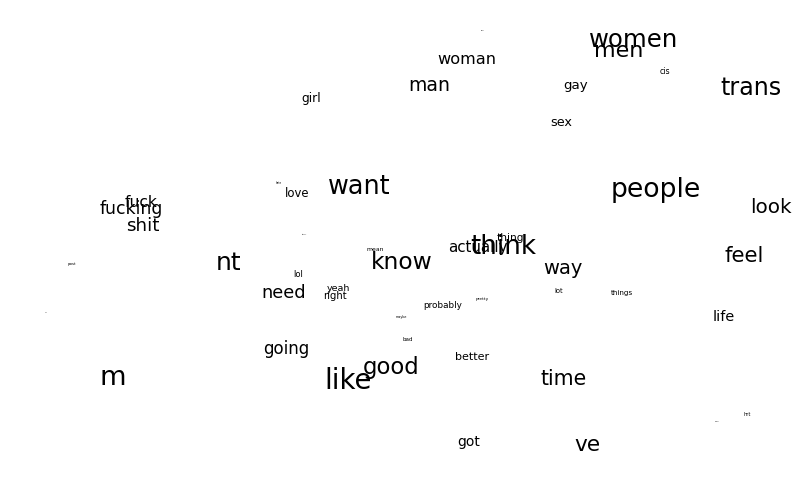

In [28]:
pca_plot(chanW2V)

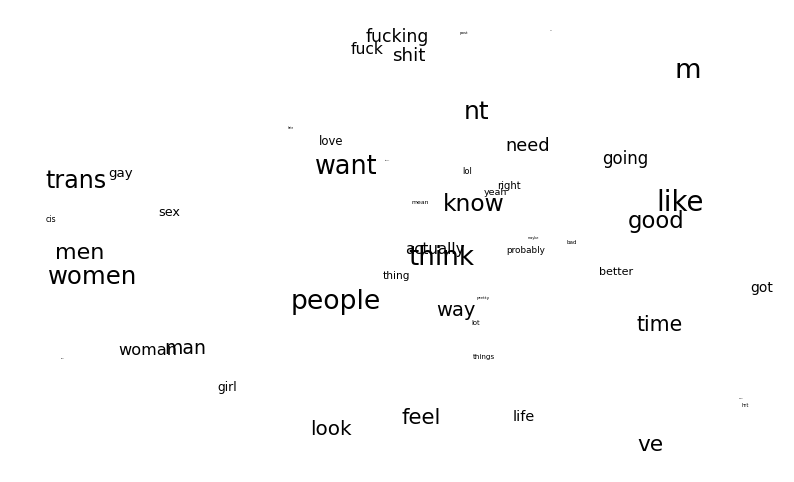

In [30]:
pca_plot(chanW2V)

Ignoring the (mildly amusing) fact that both of these have a cluster of cusswords right next to each other, these plots also reveal a few other interesting trends. In particular, "actually" and "think" are often directly next to each other, which fits well in with narratives about habitus and 4chan users. "Women" and "men" are often very close, while "trans" and "gay" are incredibly close in the second pca plot only. Tragically, these plot _also_ have "m" prominently displayed, due to my forgetfullness when tokenizing. 

Let's see what our results look like if we (chaotically) directly PCA to 2 dimensions. This should be deterministic, so we only run it once.

PCA Variance Explained: [6.034969  2.7607849]


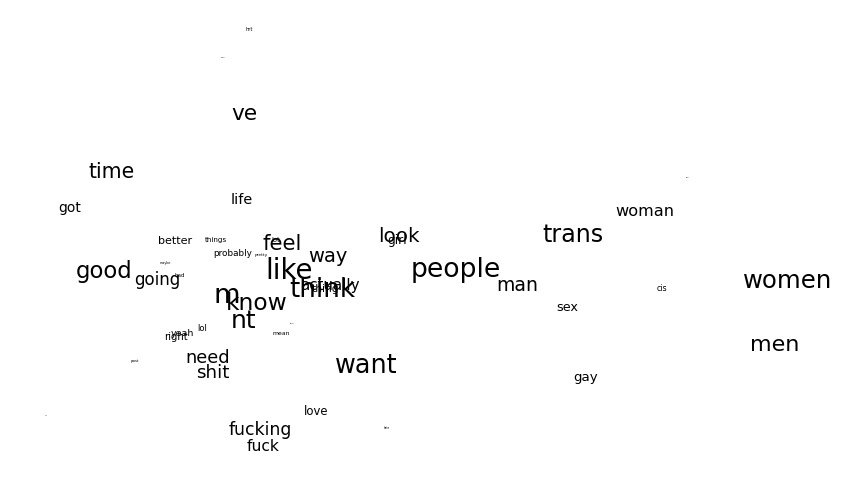

In [47]:
pca_plot(chanW2V, use_tsne=0)

The TSNE approach resulted in much more differentiation of terms than this PCA-only approach has. We seem to have a really tight clustering of "feel"/"way"/"think"/"actually", while "know"/"m"/"nt" are all near one another but slightly outside of the cluster. The latter feels like it's probably just noise caused by shared cooccurrances with the word "I," but more investigation would be needed to say for sure.

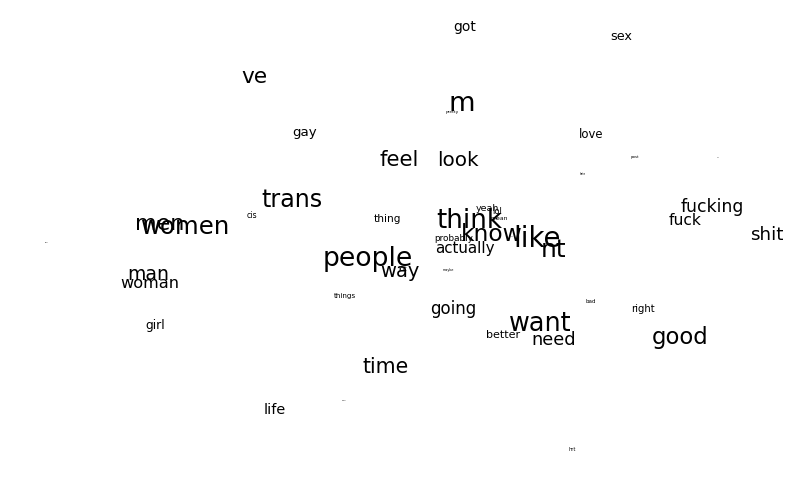

In [33]:
pca_plot(trimmedW2V)

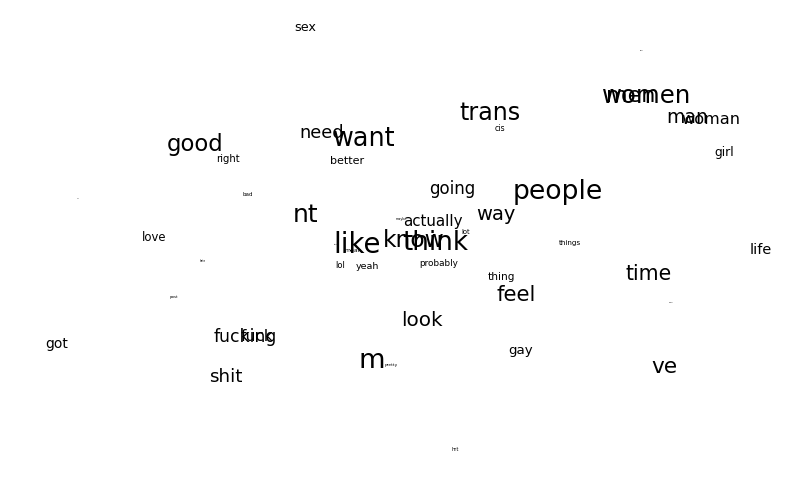

In [34]:
pca_plot(trimmedW2V)

The above plot shows "trans" as decently close to "cis" -- which is amusing, given that we know those words are decently separated in this embedding. As in our prior plots, "actually", "know", "think" are all clustered, and we still have our cluster of cuss words. "Men" and "women" are incredibly close, as are "woman" and "man," with the separation between the two clusters seemingly being due to plurality.

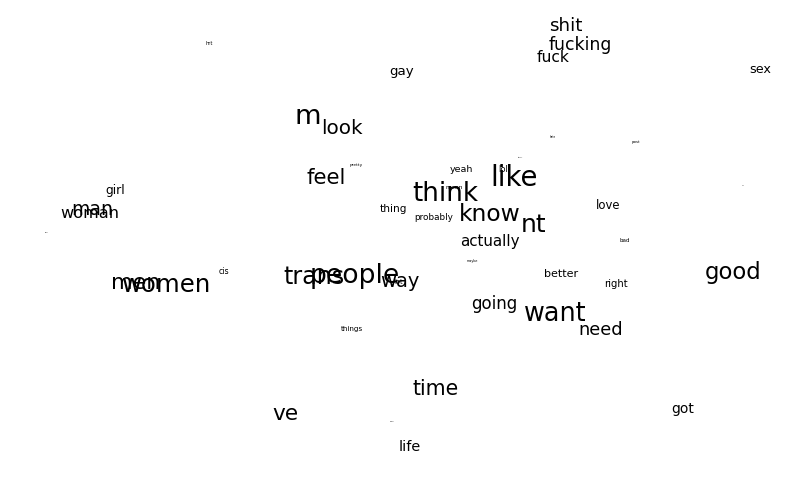

In [37]:
pca_plot(trimmedW2V, pca_components=10)

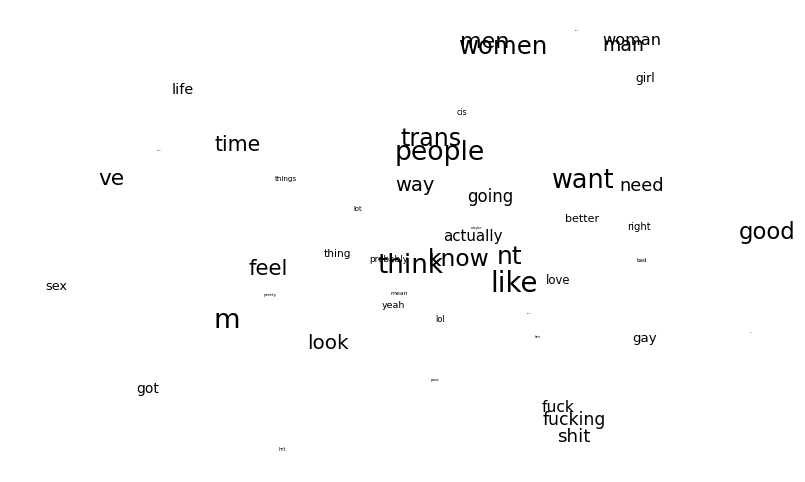

In [38]:
pca_plot(trimmedW2V, pca_components=10)

These plots were mostly made out of curiosity, but don't seem to reveal much that hasn't been seen in prior plots. Perhaps the largest change is that "trans" is closely associated with "people" in both plots. 

<font color="red">Then interrogate critical word vectors within your corpus in terms of the most similar words, analogies, and other additions and subtractions that reveal the structure of similarity and difference within your semantic space. What does this pattern reveal about the semantic organization of words in your corpora? Which estimation and visualization specification generate the most insight and appear the most robustly supported and why?

In general, it seems that the skipgrams model is performing well on our space, and doing much better than the CBOW model on our vocabulary of interest. The most "obvious" advantage of the skipgram embedding over the CBOW one is that it does not portray "trans" as incredibly close to "cis," which (while accurate in a sense) is not quite the relationship we're looking for.

Towards more fully understanding the skipgram space, let's get a rough idea of the answers to two additional questions:
1. Is "lgbt" more "cis" or "trans"?
2. Where is "chaser" in the space?

In [51]:
trimmedW2V.wv.distances("lgbt", ("cis", "trans"))

array([0.5559159 , 0.37570453], dtype=float32)

Apparently LGBT is closer to "cis" than "trans." This adds nuance to the "/lgbt/ is more trans than cis" hypothesis; just because the space seems to have a disproportionately large quantity of trnas people does not mean that cis is still not closer to the default for "lgbt". 

In [52]:
trimmedW2V.wv.most_similar('chaser')

[('gayden', 0.8709893226623535),
 ('transbian', 0.8653145432472229),
 ('f', 0.8587450981140137),
 ('lesbian', 0.8528342843055725),
 ('virgin', 0.8493313193321228),
 ('chasers', 0.8373370170593262),
 ('cism', 0.826591968536377),
 ('pan', 0.8251481056213379),
 ('coomer', 0.8246141672134399),
 ('bisexual', 0.8209228515625)]

It's interesting but sensible enough that "transbian," denotatively just a trans lesbian, is one of the more semantically similar options on this list. Less clear but believable is the prominence of "virgin" on the list, which could be the result of chasers getting mocked on the board. "cism" being less similar than "f", however, is incredibly shocking, particularly as chasers are stereotypically cis men.

## <font color="red">*Exercise 2*</font>

<font color="red">Construct cells immediately below this that embed documents related to your final project using `doc2vec`, and explore the relationship between different documents and the word vectors you analyzed in the last exercise. Consider the most similar words to critical documents, analogies (doc _x_ + word _y_), and other additions and subtractions that reveal the structure of similarity and difference within your semantic space. What does this pattern reveal about the documentary organization of your semantic space?

We consider threads to be documents, which (unfortunately) means we need to do some aggregation.

In [53]:
chan.head()

,subject,id,author,time,content,clean_content,tokens,refs,urls,tokenized_sents,normalized_sents
0,lesgen is disgusting,34346616,Anonymous,01/21/24(Sun)06:32:18 No.34346616,>go on lesgen>expecting it to be bad but had n...,>go on lesgen>expecting it to be bad but had n...,"[>, go, on, lesgen, >, expecting, it, to, be, ...",[],[],"[[go, on, lesgen, expecting, it, to, be, bad, ...","[[lesgen, expecting, bad, clue, depraved, was>..."
1,lesgen is disgusting,34346631,Anonymous,01/21/24(Sun)06:35:09 No.34346631,>>34346616They include transbians tooWhat you ...,\nThey include transbians tooWhat you expect?,"[They, include, transbians, tooWhat, you, expect]",['>>34346616'],[],"[[], [They, include, transbians, tooWhat, you,...","[[], [include, transbians, toowhat, expect]]"
2,lesgen is disgusting,34346636,Anonymous,01/21/24(Sun)06:35:41 No.34346636,>>34346616>goes to lesgen right now>ctrl + f d...,"\n>goes to lesgen right now>ctrl + f diaper, l...","[>, goes, to, lesgen, right, now, >, ctrl, +, ...",['>>34346616'],[],"[[goes, to, lesgen, right, now, ctrl, f, diape...","[[goes, lesgen, right, ctrl, f, diaper, loli, ..."
3,lesgen is disgusting,34346654,Anonymous,01/21/24(Sun)06:37:51 No.34346654,>>34346636i meant the discord,\ni meant the discord,"[i, meant, the, discord]",['>>34346636'],[],"[[i, meant, the, discord]]","[[meant, discord]]"
4,lesgen is disgusting,34346667,Anonymous,01/21/24(Sun)06:39:55 No.34346667,>>34346654I was in the wlwgen discord whenever...,\nI was in the wlwgen discord whenever that wa...,"[I, was, in, the, wlwgen, discord, whenever, t...",['>>34346654'],[],"[[I, was, in, the, wlwgen, discord, whenever, ...","[[wlwgen, discord, thingit, nice, enoughwonder..."


In [77]:
chanThreads = chan.groupby('subject').agg(
    sents = pd.NamedAgg(column='normalized_sents', aggfunc='sum')
    ).reset_index()
chanThreads.head()

,subject,sents
0,"""IT'S JUST A FETISH BRO""(...)",[[https://old.reddit.com/r/asktransgender/comm...
1,"""sapphic""","[[nan], [jellie, cause, sexually, liberated, l..."
2,"""trans dyke""","[[nan], [nt, like, living, life, ablooblooooob..."
3,/CIPG/: Could I pass general,"[[general, rate, potential, passability, repre..."
4,/Chasergen/ - Sandwich Edition,"[[qott], [cook, partner, right, anon], [qott],..."


In [85]:
def flatten_sents(sents):
    '''
    Given a list of lists, flattens the list.
    '''
    rv = []
    for sent in sents:
        for word in sent:
            rv.append(word)
    return rv

chanThreads['words'] = chanThreads['sents'].apply(lambda x: flatten_sents(x))
chanThreads.head()

,subject,sents,words
0,"""IT'S JUST A FETISH BRO""(...)",[[https://old.reddit.com/r/asktransgender/comm...,[https://old.reddit.com/r/asktransgender/comme...
1,"""sapphic""","[[nan], [jellie, cause, sexually, liberated, l...","[nan, jellie, cause, sexually, liberated, livi..."
2,"""trans dyke""","[[nan], [nt, like, living, life, ablooblooooob...","[nan, nt, like, living, life, ablooblooooobloo..."
3,/CIPG/: Could I pass general,"[[general, rate, potential, passability, repre...","[general, rate, potential, passability, repres..."
4,/Chasergen/ - Sandwich Edition,"[[qott], [cook, partner, right, anon], [qott],...","[qott, cook, partner, right, anon, qott, yeah,..."


Annoying but notable that my "strip the URLs" regex isn't working. That will be a future problem to be resolved when I update the script.

We tag our documents per a rough keyword list. (I did previously attempted something slightly more clever to help discover keywords, but the approach did not pan out, so I'll have to retry it a different week).

In [183]:
keywords = ['chaser', 'trans', 'gay', 'lesbian', 'cis', 'bisexual', 'straight']

In [184]:
from gensim.models.doc2vec import TaggedDocument

taggedDocs = []
for index, row in chanThreads.iterrows():
    docKeywords = [s for s in keywords if s in row['words']]
    docKeywords.append(row['subject']) 
    taggedDocs.append(gensim.models.doc2vec.TaggedDocument(words = row['words'], tags=docKeywords))
 
chanThreads['TaggedDocs'] = taggedDocs

In [185]:
chanD2V = gensim.models.doc2vec.Doc2Vec(chanThreads['TaggedDocs'], vector_size=100)

Let's do a quick idiot test to make sure the space is somewhat reasonably aligned. In particular, we should expect chasergen to be close to chaser.

In [186]:
chanD2V.docvecs.most_similar('chaser')

[('34383570', 0.5596853494644165),
 ('34412665', 0.555512547492981),
 ('/chasergen/', 0.5347020626068115),
 ('chasers', 0.5327009558677673),
 ('34374195', 0.5053194761276245),
 ('Bunny Lounge', 0.48533323407173157),
 ('/chasergen/ - why do trans wom(...)', 0.46524596214294434),
 ('34369122', 0.4570811688899994),
 ('/passgen/ inception edition', 0.4512868821620941),
 ('34346695', 0.44698554277420044)]

That works. Now let's investigate the locations of some of our words and documents in space, starting with a word-to-word comparison. As a confession, most of the code for this section will be blatantly stolen from the examples; no need to reinvent the wheel, after all.

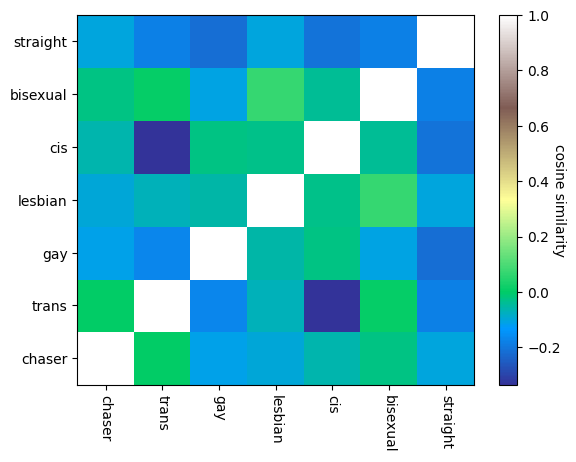

In [187]:
heatmapMatrix = []
for tagOuter in keywords:
    column = []
    tagVec = chanD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in keywords:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, chanD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrix.append(column)
heatmapMatrix = np.array(heatmapMatrix)

fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrix, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrix.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrix.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(keywords, minor=False, rotation=270)
a = ax.set_yticklabels(keywords, minor=False)

One of the larger takeaways from this is that our keywords tend to be fairly distinct, with even our most similar keywords ["chaser" and "woman"] being rather different from one another. That was essentially my goal when I selected this, so that's working as intended. 

To select our seven documents of interest, I'd like to pick the seven threads with the most tokens.

In [188]:
chanThreads['numTokens'] = chanThreads['words'].apply(len)
threads = chanThreads.sort_values(by='numTokens', ascending=False)[:8].get('subject').to_list()
threads

['/mtfg/ - male to female genera(...)',
 '/gaygen/',
 '/mtfg/ male to female general',
 '/chasergen/',
 '/bigen/ - Bisexual General',
 'What happens to the Elder Tran(...)',
 '/ftmg/ - female to male genera(...)',
 '/sig/ - lgbt self improvement (...)']

With our threads in hands let's plot inter-thread similarities:

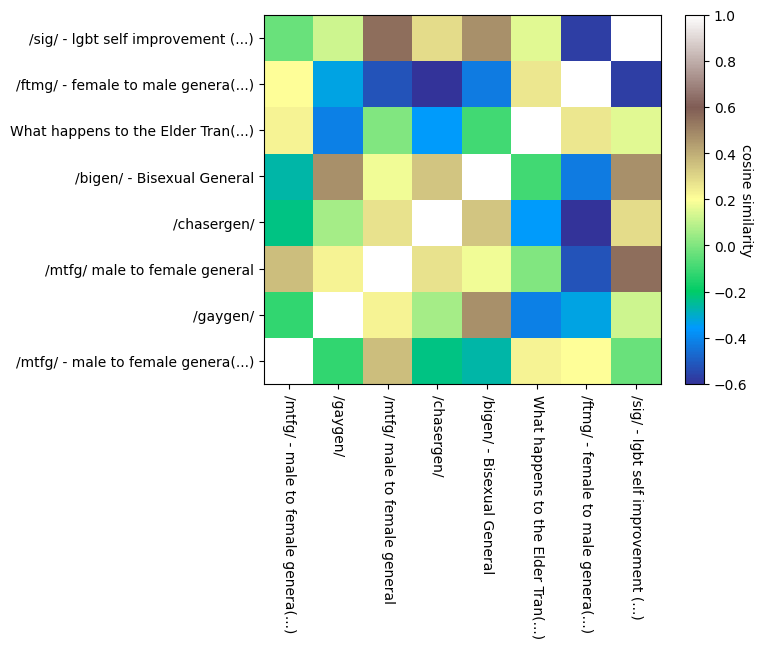

In [189]:
heatmapMatrixD = []

for tagOuter in threads:
    column = []
    tagVec = chanD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in threads:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, chanD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrixD.append(column)
heatmapMatrixD = np.array(heatmapMatrixD)

fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrixD, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrixD.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrixD.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(threads, minor=False, rotation=270)
a = ax.set_yticklabels(threads, minor=False)

Our threads have much more similarity than our documents did. Amusingly, the most different appear to be the /mtfg/s and /ftmg/ -- two threads targetted at trans people -- while the most similar are /bigen/ and /gaygen/. /chasergen/ is more similar to either of the /mtfg/ threads than to /ftmg/, which could provide evidence for chasers being more interested in trans women than in trans men. Most interestingly, /sig/ is _incredibly_ similar to /mtfg/ but less similar to /ftmg/, with no abundantly clear reason for this trend.

Lastly, lets look at some document-word similarities. 

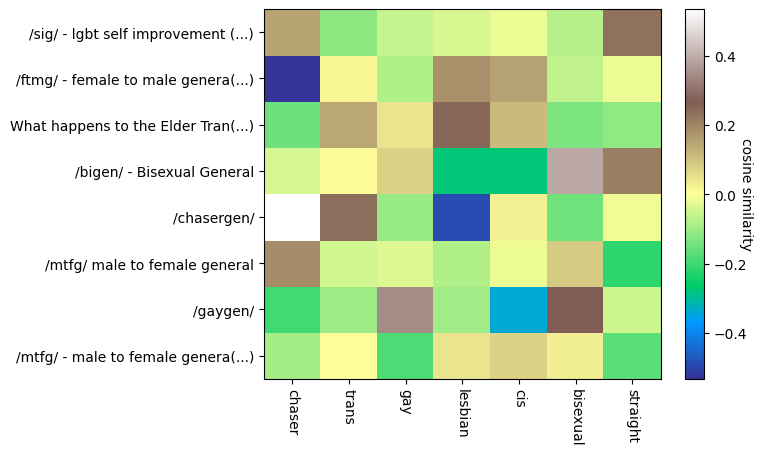

In [190]:
heatmapMatrixC = []

for tagOuter in threads:
    column = []
    tagVec = chanD2V.docvecs[tagOuter].reshape(1, -1)
    for tagInner in keywords:
        column.append(sklearn.metrics.pairwise.cosine_similarity(tagVec, chanD2V.docvecs[tagInner].reshape(1, -1))[0][0])
    heatmapMatrixC.append(column)
heatmapMatrixC = np.array(heatmapMatrixC)

fig, ax = plt.subplots()
hmap = ax.pcolor(heatmapMatrixC, cmap='terrain')
cbar = plt.colorbar(hmap)

cbar.set_label('cosine similarity', rotation=270)
a = ax.set_xticks(np.arange(heatmapMatrixC.shape[1]) + 0.5, minor=False)
a = ax.set_yticks(np.arange(heatmapMatrixC.shape[0]) + 0.5, minor=False)

a = ax.set_xticklabels(keywords, minor=False, rotation=270)
a = ax.set_yticklabels(threads, minor=False)

/chasergen/ is (unsurprisingly) very close to "chaser". The word "chaser" is also very far from "/ftmg/", which provides additional conenctions between chasers and trans women. 

More surprisingly, trans is nearly orthogonal to both /mtfg/ and /ftmg/, which seems strange for threads that are (titularly) aimed at trans people. In context of our previous discovery that "/mtfg/" is similar to "/sig/", it's surprising that they are so dissimilar in this case. 

"What happens to the Elder Tran(...)" seems to be a thread about elder trans people, and it is similar to a surprisingly large quantity of our keywords. Oddly, it's most similar to "lesbian" -- maybe the discussion focused on trans lesbians? 

Let's pull at a few of these threads. Namely:
1. What words is /chasergen/ similar to?
2. What words is /sig/ similar to?
3. What words are the "What happens to Elder Tran(...)" document similar to?

(Unfortunately, as most of my documents have informative names like 34355204, investigating document-document or word-document similarities is less informative).

In [195]:
sig, eldertrans, chaser = threads[-1], threads[-3], threads[3]
chanD2V.wv.most_similar( chanD2V[sig] )

[('emptiness', 0.8021363615989685),
 ('nursing', 0.788124680519104),
 ('journaling', 0.7608373165130615),
 ('tracking', 0.7537515163421631),
 ('outside', 0.7452446222305298),
 ('places', 0.7427154183387756),
 ('jobs', 0.7416688203811646),
 ('nightmares', 0.7361495494842529),
 ('detox', 0.7215061187744141),
 ('hosting', 0.7191564440727234)]

/sig/ seems to have much discussion not just about self improvement itself ("journaling", "tracking", "jobs", "outside") but also about the struggles that its users are going through ("emptiness", "nightmares", "detox"). This makes the similarity to the /mtfg/ thread even more interesting -- does that thread have a large amount of discussion of this form? -- although pursuing that is a bit further than this analysis will extend.

In [197]:
chanD2V.wv.most_similar( chanD2V[eldertrans] )

[('medical', 0.7192643284797668),
 ('psychologists', 0.7139641642570496),
 ('fully', 0.7076292037963867),
 ('replacing', 0.7018336057662964),
 ('transitioning', 0.6958532929420471),
 ('issues', 0.6922599077224731),
 ('drastically', 0.6821235418319702),
 ('knowledge', 0.6785050630569458),
 ('transferring', 0.6737779974937439),
 ('estimate', 0.6732137203216553)]

This threads most similar words complicates our semantic embedding. It contains "medical", "psychologists", "fully", and "transitioning". These are all words one would expect to be used in discussions _of_ trans people, particularly over the past few decades where the legal bars to transitioning were much higher. Yet eldertrans wasn't all that similar to /mtfg/ or /ftmg/. This could indicate that, while those threads are largely intended for trans people, they aren't discussing the processes of transitioning too closely, or (if they are) there is some meaningful difference between said discussions and those seen on the eldertrans thread.

In [198]:
chanD2V.wv.most_similar( chanD2V[chaser] )

[('thailand', 0.7089661955833435),
 ('stray', 0.603752613067627),
 ('single', 0.583562970161438),
 ('desperation', 0.5770875215530396),
 ('tranners', 0.5702238082885742),
 ('thott', 0.5630905628204346),
 ('perv', 0.5552535653114319),
 ('tagmap', 0.5508878827095032),
 ('grindr', 0.5480670928955078),
 ('secondly', 0.5469124913215637)]

Many of these similarities are sensible at a glance -- "thailand"*, "tranners", "thott", "perv", and "grindr" all make pletny of sense on a thread targetted at chasers. "Desperation" and "single" also make some sense, with the terms maybe referring to users being desperately single. 

It's less clear what "stray", "tagmap", and "secondly" are doing in this list; close reading of where those words pop up might be helpful here.

<font size=1.5>\*In certain forums, Thailand is stereotyped as having a large quantity of trans women.

## <font color="red">*Exercise 3*</font>

<font color="red">Construct cells immediately below this that embed documents related to your final project, then generate meaningful semantic dimensions based on your theoretical understanding of the semantic space (i.e., by subtracting semantically opposite word vectors) and project another set of word vectors onto those dimensions. Interpret the meaning of these projections for your analysis. Which of the dimensions you analyze explain the most variation in the projection of your words and why?

<font color="red">***Stretch***: Average together multiple antonym pairs to create robust semantic dimensions. How do word projections on these robust dimensions differ from single-pair dimensions?

We're going to continue with the use of the 4chan dataset, and specifically with our skipgram word2vec model. 


In [221]:
def normalize(vector):
    return vector / np.linalg.norm(vector)

def dimension(model, positives, negatives):
    diff = sum([normalize(model.wv[x]) for x in positives]) - sum([normalize(model.wv[x]) for x in negatives])
    return diff

MascFem = dimension(trimmedW2V, ['man', 'men'], ['woman', 'women'])
TransCis = dimension(trimmedW2V, ['nonbinary', 'trans', 'transgender', 'transsexual', 'mtf', 'ftm', 'transwoman', 'transmen'], ['cis', 'cisgender', 'ciswoman', 'cisman', 'cisf', 'cism'])
# stealing this
BlackWhite = dimension(trimmedW2V, ['black','blacks'], ['white', 'whites'])



I don't currently have an extensive number of words I want to project, so unfortunately I'll be projecting fewer words than those in the example.

In [262]:
SomeWords = ['lgbt', 'lesbian', 'gay', 'chaser', 'hon', 'passing', 'pass', 'manmode', 'girlmode', 'boymode', 'incel', 'dysphoria', 'euphoria']

def makeDF(model, word_list, dimensions):
    df = {dim_name:[] for dim_name in dimensions.keys()}
    for dim_name, dim in dimensions.items():
        for word in word_list:
            df[dim_name].append(sklearn.metrics.pairwise.cosine_similarity(model.wv[word].reshape(1, -1), dim.reshape(1,-1))[0][0])
    df = pd.DataFrame(df, index = word_list)
    return df

wordsDf = makeDF(trimmedW2V, SomeWords, {'MascFem':MascFem, 'TransCis':TransCis, 'BlackWhite':BlackWhite})

Stealing the plotting helper functions:

In [263]:
def Coloring(Series):
    x = Series.values
    y = x-x.min()
    z = y/y.max()
    c = list(plt.cm.rainbow(z))
    return c

def PlotDimension(ax,df, dim):
    ax.set_frame_on(False)
    ax.set_title(dim, fontsize = 20)
    colors = Coloring(df[dim])
    for i, word in enumerate(df.index):
        ## Attaching values for interpretability
        ann_word = f'{word} {str(round(df[dim][i], 2))}'
        ax.annotate(ann_word, (0, df[dim][i]), color = colors[i], alpha = 0.6, fontsize = 12)
    MaxY = df[dim].max()
    MinY = df[dim].min()
    plt.ylim(MinY,MaxY)
    plt.yticks(())
    plt.xticks(())

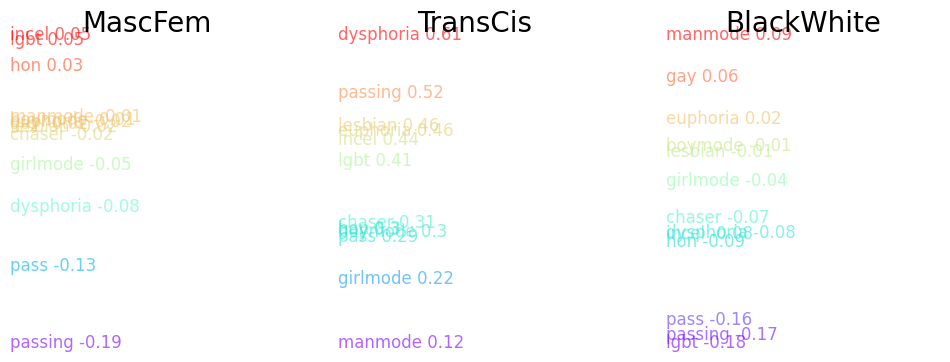

In [264]:
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, wordsDf, 'MascFem')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, wordsDf, 'TransCis')
ax3 = fig.add_subplot(133)
PlotDimension(ax3, wordsDf, 'BlackWhite')
plt.show()

Interestingly, essentially every word I provided leans at least _slightly_ trans. This makes sense for some of the words -- "hon", for instance, is a (somewhat insulting) word used directly in reference to trans women. "Incel" also follows some stereotypical trends, with the most interesting result being that "incel" is largely "trans" and less "cis". 

As a last note of particular interest, "pass", "passing", and "lgbt" are all more white than black, with most every other word being on the borderline between the two. 

Overall, the trans/cis dichotomy seems to explain most of the variation in my words here, although that is somewhat by design for the above word list. Future inquiries into this will almost certainly need to use a more intentional word list than the above.

After reading the above, I realized that occupations could also be somewhat interesting -- with the disclaimer that 4chan is unliekly to have many appearances of any given occupation, limiting how far they are projeced. Let's take a very quick peak at that as well:

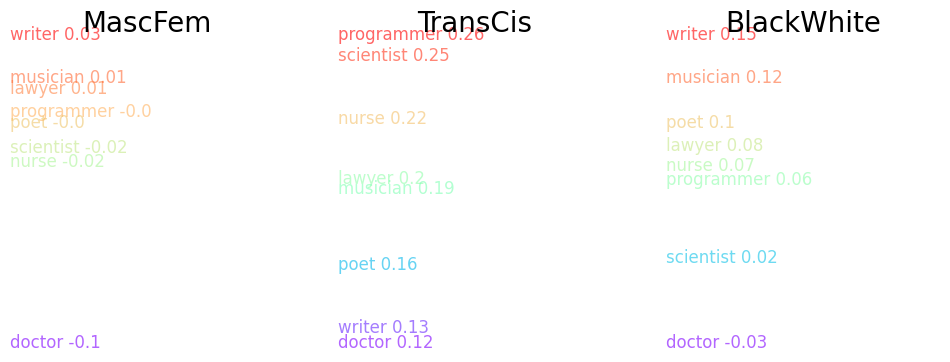

In [265]:
Occupations = ["doctor","lawyer","scientist","musician","writer", "programmer", "poet", "nurse"]
occDf = makeDF(trimmedW2V, Occupations, {'MascFem':MascFem, 'TransCis':TransCis, 'BlackWhite':BlackWhite})
fig = plt.figure(figsize = (12,4))
ax1 = fig.add_subplot(131)
PlotDimension(ax1, occDf, 'MascFem')
ax2 = fig.add_subplot(132)
PlotDimension(ax2, occDf, 'TransCis')
ax3 = fig.add_subplot(133)
PlotDimension(ax3, occDf, 'BlackWhite')
plt.show()

Trans-Cis and Black-White both seem to capture a good amount of variation for this, with Black-White capturing _just_ a little bit more. Oddly, all of these words _also_ lean towards "trans" (although it is less surprising that specifically "programmer" leans trans, given understudied trends of trans women being tech savvy).

As a potentially interesting future dimension that will be covered in a later analysis: ftm vs mtf.

## <font color="red">*Exercise 4*</font>

<font color="red">Construct cells immediately below this that align word embeddings over time or across domains/corpora. Interrogate the spaces that result and ask which words changed most and least over the entire period or between contexts/corpora. What does this reveal about the social game underlying your space?

We are going to make use of the helper functions from the example, so we should bring them down here.

In [4]:
def calc_syn0norm(model):
    """since syn0norm is now depricated"""
    return (model.wv.syn0 / np.sqrt((model.wv.syn0 ** 2).sum(-1))[..., np.newaxis]).astype(np.float32)

def smart_procrustes_align_gensim(base_embed, other_embed, words=None):
    """Procrustes align two gensim word2vec models (to allow for comparison between same word across models).
    Code ported from HistWords <https://github.com/williamleif/histwords> by William Hamilton <wleif@stanford.edu>.
    (With help from William. Thank you!)
    First, intersect the vocabularies (see `intersection_align_gensim` documentation).
    Then do the alignment on the other_embed model.
    Replace the other_embed model's syn0 and syn0norm numpy matrices with the aligned version.
    Return other_embed.
    If `words` is set, intersect the two models' vocabulary with the vocabulary in words (see `intersection_align_gensim` documentation).
    """
    base_embed = copy.copy(base_embed)
    other_embed = copy.copy(other_embed)
    # make sure vocabulary and indices are aligned
    in_base_embed, in_other_embed = intersection_align_gensim(base_embed, other_embed, words=words)

    # get the embedding matrices
    # base_vecs = calc_syn0norm(in_base_embed)
    # other_vecs = calc_syn0norm(in_other_embed)
    base_vecs= [in_base_embed.wv.get_vector(w,norm=True) for w in set(in_base_embed.wv.index_to_key)]
    other_vecs= [in_other_embed.wv.get_vector(w,norm=True) for w in set(in_other_embed.wv.index_to_key)]

    # just a matrix dot product with numpy
    m = np.array(other_vecs).T.dot(np.array(base_vecs))
    # SVD method from numpy
    u, _, v = np.linalg.svd(m)
    # another matrix operation
    ortho = u.dot(v)
    # Replace original array with modified one
    # i.e. multiplying the embedding matrix (syn0norm)by "ortho"
    other_embed.wv.vectors =(np.array(other_vecs)).dot(ortho)
    return other_embed

def intersection_align_gensim(m1,m2, words=None):
    """
    Intersect two gensim word2vec models, m1 and m2.
    Only the shared vocabulary between them is kept.
    If 'words' is set (as list or set), then the vocabulary is intersected with this list as well.
    Indices are re-organized from 0..N in order of descending frequency (=sum of counts from both m1 and m2).
    These indices correspond to the new syn0 and syn0norm objects in both gensim models:
        -- so that Row 0 of m1.syn0 will be for the same word as Row 0 of m2.syn0
        -- you can find the index of any word on the .index2word list: model.index2word.index(word) => 2
    The .vocab dictionary is also updated for each model, preserving the count but updating the index.
    """

    # Get the vocab for each model
    vocab_m1 = set(m1.wv.index_to_key)
    vocab_m2 = set(m2.wv.index_to_key)

    # Find the common vocabulary
    common_vocab = vocab_m1&vocab_m2
    if words: common_vocab&=set(words)

    # If no alignment necessary because vocab is identical...
    if not vocab_m1-common_vocab and not vocab_m2-common_vocab:
        return (m1,m2)

    # Otherwise sort by frequency (summed for both)
    common_vocab = list(common_vocab)
    common_vocab.sort(key=lambda w: m1.wv.get_vecattr(w, "count")  + m2.wv.get_vecattr(w, "count") ,reverse=True)

    # Then for each model...
    for m in [m1,m2]:
        # Replace old syn0norm array with new one (with common vocab)
        new_arr = [m.wv.get_vector(w,norm=True) for w in common_vocab]

        # Replace old vocab dictionary with new one (with common vocab)
        # and old index2word with new one
        m.index2word = common_vocab
        # old_vocab = m.wv.index_to_key
        new_vocab = []
        k2i={}
        for new_index,word in enumerate(common_vocab):
            new_vocab.append(word)
            k2i[word]=new_index
        m.wv.index_to_key=new_vocab
        m.wv.key_to_index=k2i
        m.wv.vectors=np.array(new_arr)

    return (m1,m2)

def compareModels(df, category, text_column_name='normalized_sents', sort = True, embeddings_raw={}):
    """If you are using time as your category sorting is important"""
    if len(embeddings_raw) == 0:
        embeddings_raw = rawModels(df, category, text_column_name, sort)
    cats = sorted(set(df[category]))
    #These are much quicker
    embeddings_aligned = {}
    for catOuter in cats:
        embeddings_aligned[catOuter] = [embeddings_raw[catOuter]]
        for catInner in cats:
            embeddings_aligned[catOuter].append(smart_procrustes_align_gensim(embeddings_aligned[catOuter][-1], embeddings_raw[catInner]))
    return embeddings_raw, embeddings_aligned

def rawModels(df, category, text_column_name='normalized_sents', sort = True):
    embeddings_raw = {}
    cats = sorted(set(df[category]))
    for cat in cats:
        #This can take a while
        print("Embedding {}".format(cat), end = '\r')
        subsetDF = df[df[category] == cat]
        #You might want to change the W2V parameters
        embeddings_raw[cat] = gensim.models.word2vec.Word2Vec(subsetDF[text_column_name].sum())
    return embeddings_raw

def getDivergenceDF(word, embeddingsDict):
    dists = []
    cats = sorted(set(embeddingsDict.keys()))
    dists = {}
    print(word)
    for cat in cats:
        dists[cat] = []
        for embed in embeddingsDict[cat][1:]:
            dists[cat].append(np.abs(1 - sklearn.metrics.pairwise.cosine_similarity(np.expand_dims(embeddingsDict[cat][0].wv[word], axis = 0),
                                                                             np.expand_dims(embed.wv[word], axis = 0))[0,0]))
    return pd.DataFrame(dists, index = cats)

def findDiverence(word, embeddingsDict):
    cats = sorted(set(embeddingsDict.keys()))

    dists = []
    for embed in embeddingsDict[cats[0]][1:]:
        try:
            dists.append(1 - sklearn.metrics.pairwise.cosine_similarity(np.expand_dims(embeddingsDict[cats[0]][0].wv[word], axis = 0), np.expand_dims(embed.wv[word], axis = 0))[0,0])
        except:
            pass
    return np.mean(dists)

def findMostDivergent(embeddingsDict, original_words):
#    original_words = comparedEmbeddings[1950][0].wv.index_to_key
    for embeds in embeddingsDict.values():
        for embed in embeds:
            original_words = set(original_words).intersection(set(embed.wv.index_to_key))
    words = set(original_words)
    print("Found {} words to compare".format(len(words)))
    print(words)
    return sorted([(w, findDiverence(w, embeddingsDict)) for w in words], key = lambda x: x[1], reverse=True)

def file_to_embeddings(address, kind):
    rawEmbeddings = {}
    for file in os.listdir(address):
        if "embedding_"+kind in file:
            e, kind_, kind_type = file.split("_")
            kind_type = eval(kind_type)
            rawEmbeddings[kind_type] = Word2Vec.load(file)
    return rawEmbeddings

As per the dynamic topic modeling exercise last week, I do not currently have usable time series data. Thus, I'm going to work with the "mag" genre from COHA. I also retain my bins from last week, since they seemed reasonably selected at the time.

In [5]:
coha_mag_df = pd.DataFrame(columns = ['Year', 'sents', 'normalized_sents'])

The following is the code I used to generate my epochs; I didn't save it from last week (\*grumble grumble\*), so I had to rerun it this week.

Additionally, it appears that this week we need the words to be not just tokenized also to maintain the sentence structure. That task differs from last week, and (amusingly) differs from the example code above.

In [10]:
for article in coha_texts:
    genre, year, id_ = article.split('_')

    if genre.lower() != 'mag': continue

    year = int(year)

    try:
        if len(coha_texts[article][2]) < 1500000:
            sents = lucem_illud.sent_tokenize(coha_texts[article][2].decode('utf-8'))
            normalized_sents = [lucem_illud.normalizeTokens(s, lemma=False) for s in sents]
            coha_mag_df.loc[id_] = [year, sents, normalized_sents]
    except TypeError:
        print('\n\nHit a type error\n\n')
        continue
    except IndexError:
        print('\n\nHit an index error\n\n')
        continue

C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' o



Hit an index error




C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' o



Hit an index error




C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' o



Hit an index error




C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
  warnings.warn(Warnings.W108)
C:\Users\wimer\AppData\Roaming\Python\Python311\site-packages\spacy\pipeline\lemmatizer.py:211: UserWarning: [W108] The rule-based lemmatizer did not find POS annotation for one or more tokens. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' o

In [13]:
def assign_epoch(year):
    if year <= 1863:
        return 0
    elif year <= 1912:
        return 1
    elif year <= 1960:
        return 2
    else:
        return 3
    
coha_mag_df['epoch'] = coha_mag_df['Year'].apply(lambda x: assign_epoch(x))

coha_mag_df

,Year,sents,normalized_sents,epoch
552651.txt,1815,[States by land and sea. - - The spinning wh...,"[[states, land, sea, spinning, wheel, loom, fr...",0
552727.txt,1816,"[txt FOR THE NORTH-AMERIcAN JOURNAL ., THE fol...","[[txt, north, american, journal], [following, ...",0
552728.txt,1816,"[txt FOR THE NORTH-AMERICAN JOURNAL ., THE Fal...","[[txt, north, american, journal], [falls, niag...",0
552807.txt,1816,"[txt FOR THE NORTH-AMERICAN J*URNAL ., On the ...","[[txt, north, american, j*urnal], [fine, arts,...",0
552808.txt,1816,"[txt On Models in Literature . "", Yet still up...","[[txt, models, literature], [uppermost, nature...",0
...,...,...,...,...
406450.txt,2009,"[Some years ago , after Sunday Mass in a small...","[[years, ago, sunday, mass, small, maine, town...",3
406451.txt,2009,"[Spread the wealth ?, Your interview with Dani...","[[spread, wealth], [interview, daniel, finn, m...",3
406452.txt,2009,[I FIRST ENCOUNTERED HER IN A COLD STONE churc...,"[[encountered, cold, stone, church, prigueux, ...",3
406453.txt,2009,[The most extreme party I 've ever attended or...,"[[extreme, party, ve, attended, heard], [mothe...",3


In [14]:
coha_mag_df.to_csv('../data/coha_mag_df_tokenized.csv', index=False) # The above function takes _way_ too long to run, so let's never have to do this again.

In [7]:
import ast
coha_mag_df = pd.read_csv('../data/coha_mag_df_tokenized.csv')

# `progress_apply` is my new favorite function.
coha_mag_df['normalized_sents'] = coha_mag_df['normalized_sents'].progress_apply(lambda x: ast.literal_eval(x))

100%|██████████| 61289/61289 [02:39<00:00, 384.79it/s] 


In [8]:
coha_mag_df

,Year,sents,normalized_sents,epoch
0,1815,['States by land and sea. - - The spinning w...,"[[states, land, sea, spinning, wheel, loom, fr...",0
1,1816,"['txt FOR THE NORTH-AMERIcAN JOURNAL .', 'THE ...","[[txt, north, american, journal], [following, ...",0
2,1816,"['txt FOR THE NORTH-AMERICAN JOURNAL .', 'THE ...","[[txt, north, american, journal], [falls, niag...",0
3,1816,"['txt FOR THE NORTH-AMERICAN J*URNAL .', 'On t...","[[txt, north, american, j*urnal], [fine, arts,...",0
4,1816,"['txt On Models in Literature . ""', 'Yet still...","[[txt, models, literature], [uppermost, nature...",0
...,...,...,...,...
61284,2009,"['Some years ago , after Sunday Mass in a smal...","[[years, ago, sunday, mass, small, maine, town...",3
61285,2009,"['Spread the wealth ?', 'Your interview with D...","[[spread, wealth], [interview, daniel, finn, m...",3
61286,2009,['I FIRST ENCOUNTERED HER IN A COLD STONE chur...,"[[encountered, cold, stone, church, prigueux, ...",3
61287,2009,"[""The most extreme party I 've ever attended o...","[[extreme, party, ve, attended, heard], [mothe...",3


In [9]:
import copy
#rawEmbeddings_Mag_epoch = rawModels(coha_mag_df, 'epoch')
raw_mag_epoch_embed, compared_mag_epoch_embed = compareModels(coha_mag_df, 'epoch')


Given how long the above bit of code took to figure out and run\*, I'm very excited to actually look at some words.

Let's start with "cholera", which should be old enough to appear in all of our embeddings, and should have changed in meaning over the past few centuries.


<font size=1>\*I had repurposed much of the cleaning code from the second example, but that provided a "normalized_sents" column which was _actually_ normalized tokens, so I had to rework things to make it function.

In [25]:
def plot_for_target_word(target_word, comparedEmbeddings):
    pltDF = getDivergenceDF(target_word, comparedEmbeddings)
    fig, ax = plt.subplots(figsize = (10, 7))
    seaborn.heatmap(pltDF, ax = ax, annot = False) #set annot True for a lot more information
    ax.set_xlabel("Starting Year Bin")
    ax.set_ylabel("Ending Year Bin")
    ax.set_title("Yearly linguistic change for: '{}'".format(target_word))
    plt.yticks(ticks=[.5, 1.5, 2.5, 3.5], labels=['1863-1815', '1912-1863', '1960-1912', '2009-1960'])
    plt.xticks(ticks=[.5, 1.5, 2.5, 3.5], labels=['1815-1863', '1863-1912', '1912-1960', '1960-2009'])
    plt.show()

cholera


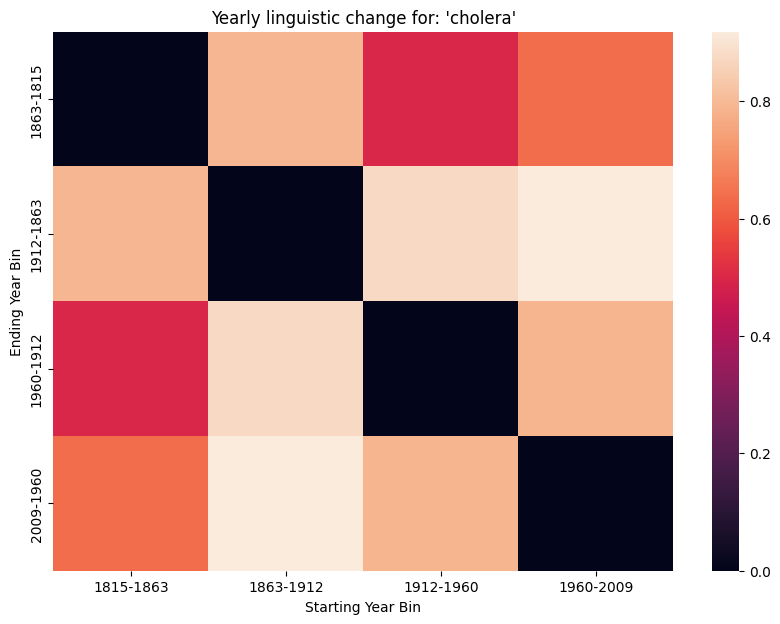

In [26]:
plot_for_target_word('cholera', compared_mag_epoch_embed)

The dramatic change followed by subtle changes over time makes sense -- 1863-1912 is approximately when the waterborne nature of the disease was discovered, which turned it from an often tragic wreaking havoc on cities to a manageable pest. That would be expected to have dramatic changes on how cholera is used in language.

Out of curiosity, let's try another word before picking any of the most or least divergent options.

electricity


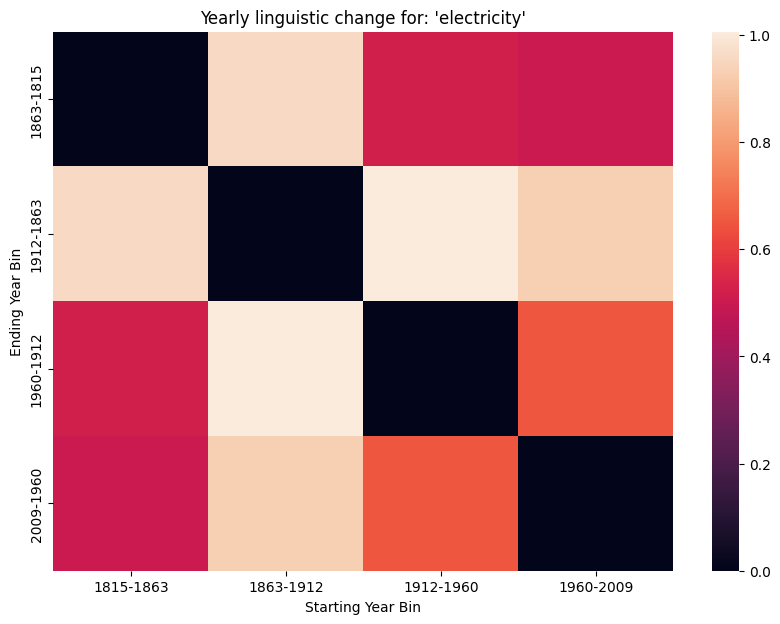

In [27]:
plot_for_target_word('electricity', compared_mag_epoch_embed)

The similarity between the oldest bin and the two newest bins is somewhat surprising, but perhaps explainable by 1863-1912 being the hay-day of electrification. That hay-day would be anticipated to have large impacts on how the word is used. Interestingly, the word's meaning does not seem to have stabilized afterwards, with continued large divergences in our other bins.

And now let's actually do the assignment.

In [20]:
wordDivergence = findMostDivergent(compared_mag_epoch_embed, compared_mag_epoch_embed[1][0].wv.index_to_key)

Found 27339 words to compare
{'squadrons', 'assuage', 'whistled', 'custom', 'shine', 'theatres', 'catholic', 'reaper', 'pruning', 'disappears', 'poole', 'interposition', 'juggler', 'gunners', 'registered', 'violating', 'dislodging', 'discussing', 'lightnings', 'diversified', 'cohesive', 'widow', 'devotions', 'exclaimed', 'lightens', 'couch', 'rang', 'excite', 'spinners', 'evans', 'cloaked', 'crusaders', 'vegetable', 'hessian', 'draft', 'misconstrued', 'condescension', 'brings', 'hogg', 'fairfax', 'banish', 'tidal', 'consort', 'emblems', 'boast', 'hostilities', 'ministerial', 'formed', 'vocations', 'hams', 'tau', 'herring', 'threadbare', 'hides', 'pleases', 'unmitigated', 'hardened', 'alleviating', 'depositors', 'mystic', 'bottle', 'transgress', 'fawning', 'submissiveness', 'intuition', 'textures', 'amputation', 'bulwark', 'compile', 'saunders', 'prostration', 'classified', 'inductive', 'slackened', 'reconciliation', 'austria', 'eyewitnesses', 'decayed', 'holds', 'farmhouses', 'queens',

In [21]:
wordDivergence[:10]

[('milford', 0.9999999371753644),
 ('mathematicians', 0.9999997364854571),
 ('persia', 0.9999997016119595),
 ('transatlantic', 0.9333388917148113),
 ('partakes', 0.8830199204385281),
 ('unhappily', 0.8760617859661579),
 ('disappearance', 0.8683631457388401),
 ('confessions', 0.8639335446059704),
 ('genesis', 0.8638750910758972),
 ('soils', 0.861748319119215)]

"Milford" changing so dramatically is interesting. My impression is that the word is usually just a name, so I'm not entirely sure what's going on there. "Mathematicians," "Persia," and "transatlantic" changing makes plenty of sense, however. Mathematics itself has changed quite a bit over the past century, so seeing it's representation change is understandable. "Persia" would be expected at face value to have it's stance in culture change as it becomes more distant of a memory. And "transatlantic" likely has different connotations acquired as the difficult of transatlantic travel waxes and wanes.

Towards contextualizing these changes, my corpera is of magazines. The rise of travel publications may have changed the meaning of "milford" in the corpera, which would also explain the heavily changed meaning of "transatlantic." 

milford


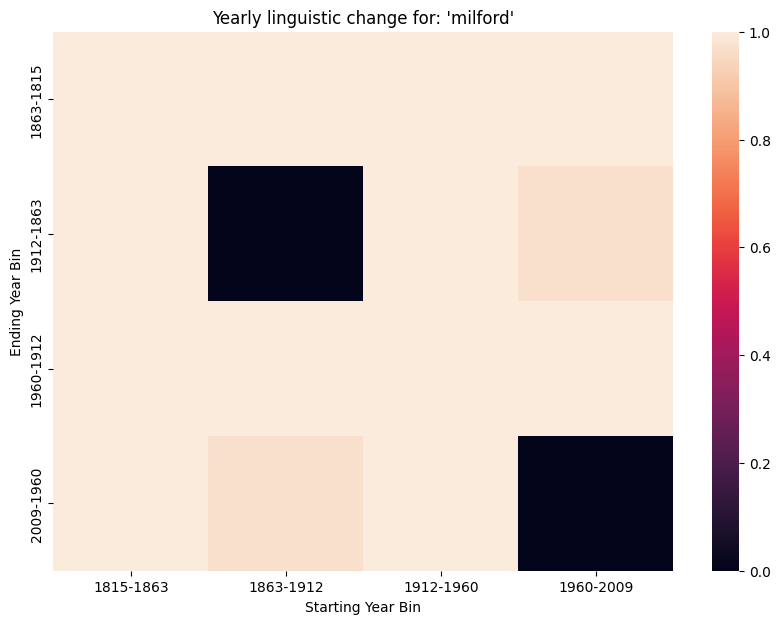

In [28]:
plot_for_target_word('milford', compared_mag_epoch_embed)

The term has heavy divergence _with itself_ in a given epoch, which indicates that something shady is going on. Let's check our other top 10 words.

mathematician


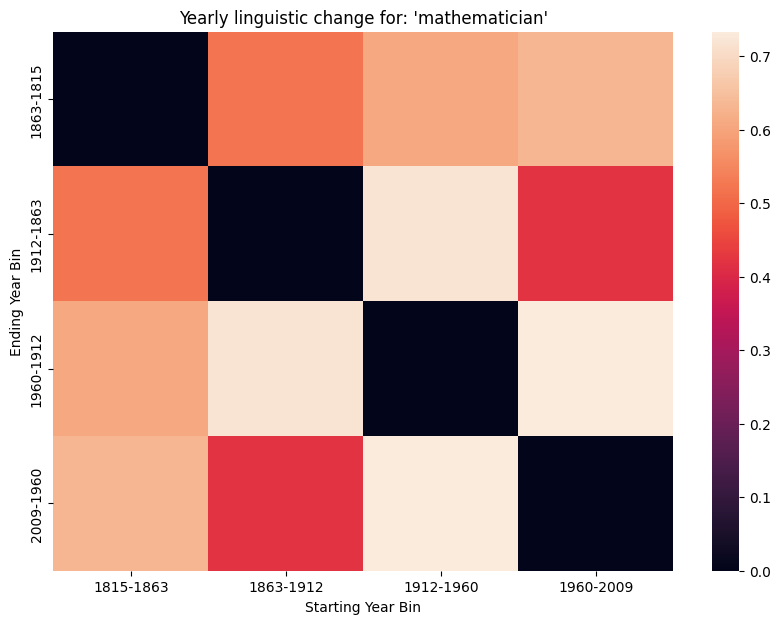

In [29]:
plot_for_target_word('mathematician', compared_mag_epoch_embed)

Mathematicians seems safe, although it is definitely rather divergent. Amusingly, the meaning in 1863-1912 is very similar to that in 1963-2012. While I want to speculate about this being somehow reflective of how mathematics is done, that theory doesn't really hold here. Under that theory, we should see 1863-1912 being realtively similar to 1912-1960 -- which they are not -- and would expec to observe large divergences in meaning between the 1863-1912 bin and the 1963-2012 bin, which is the opposite of what we observe. Further, our dataset is magazines, which (while some may provide accurate representations of the actual practice of mathematics) should probably be expected to demonstrate a laymen's understanding of what mathematicians are. 

Thus, maybe a better way of explaining this is that the semantic meaning of mathematicians in 1863-1912 is similar to that seen from 1960-2009, although it's still not clear why that should be the case.


With that mystery opened, let's look at some of our least divergent words.

In [22]:
wordDivergence[-10:]

[('polonius', 0.21343177556991577),
 ('banging', 0.21099498867988586),
 ('sled', 0.2060149610042572),
 ('scion', 0.20586064457893372),
 ('liver', 0.2022346705198288),
 ('butter', 0.19978117942810059),
 ('kite', 0.19858765602111816),
 ('roseate', 0.19560973346233368),
 ('vehicles', 0.18126367032527924),
 ('frown', 0.1661892533302307)]

Many of these words are fairly objective things that shouldn't change in meaning too often. However, "vehicles" not changing is surprising, especially given the adoption of the term to refer to automobiles.

Let's check that our least divergent word, contrary to our most divergent word, does not have anything silly going on:

frown


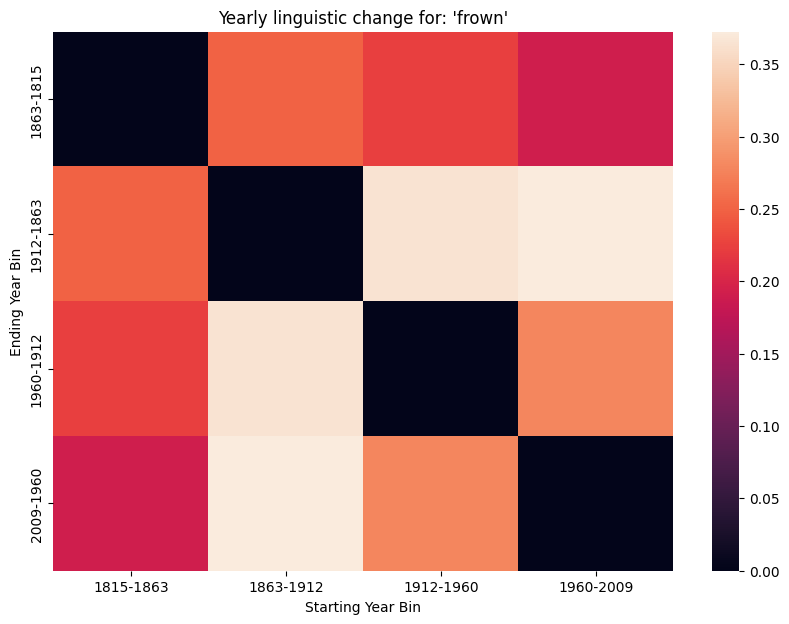

In [30]:
plot_for_target_word('frown', compared_mag_epoch_embed)

This appears fairly expected for a non-divergent word. The semantic meaning has changed _some_, but stays relatively constant. Let's check "kite"

kite


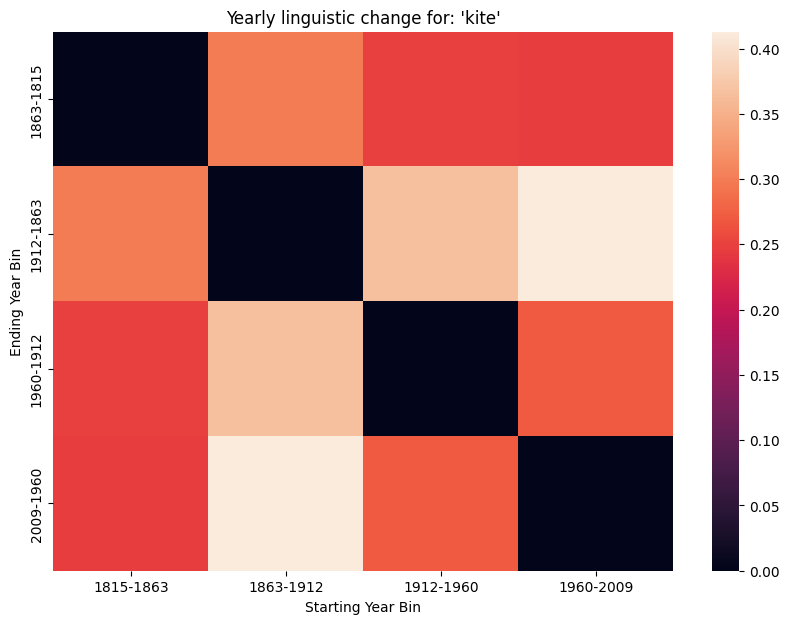

In [32]:
plot_for_target_word('kite', compared_mag_epoch_embed)

As before, this is a relatively unchanged word. However, also as before, we have a relatively large linguisitic shift occuring for the 1863-1912 bin. If I recall correctly, that bin has a _much_ larger quantity of entries than its preceeding bin, so this may be an effect due to an increased proliferation (or at least recording) of writing from the era. 

There is much more we do not have time to cover on word embeddings. If you are interested in other ways to align word embeddings, take a look at the [Dynamic Word Embeddings (DTM) section from the Thinking with Deep Learning course](https://colab.research.google.com/drive/1RAiI3BIL1X9D4gzZ0rZdIJjkNNicIuKE?usp=sharing#scrollTo=COS_n2RFCJNk) or using the more recent [Temporal Word Embeddings with a Compass (TWEC) package](https://github.com/valedica/twec). There is also a useful section on [debiasing word embeddings](https://colab.research.google.com/drive/1RAiI3BIL1X9D4gzZ0rZdIJjkNNicIuKE?usp=sharing#scrollTo=JHQ--EsWoxGM), such as the famous, ["Man is to Computer Programmer as Woman is to Homemaker? Debiasing Word Embeddings"](https://arxiv.org/abs/1607.06520) paper. Below, we include an optional section on topic modeling with word embeddings, which could be useful for final projects.

## Optional: Topic modeling with word embeddings

Recently computer scientists have developed methods to cluster word embeddings, which can be viewed as a topic model, an embedding-based version of conventional topic models that use the document-term matrix (e.g., LDA). One method is Discourse Atoms, first described by Princeton NLP researchers ([Arora et al. 2018](https://arxiv.org/abs/1601.03764)). This uses k-SVD, a generalization of the k-means clustering algorithm to identify topic-like vectors in the n-dimensional word embedding space. Below is code adapted from the first social science paper using Discourse Atoms, [Arseniev-Koehler et al. 2021](https://osf.io/preprints/socarxiv/nkyaq/). It takes as input _gensim_ word vectors.

You are not required to implement this, but for class projects or your own research, this can be more useful than conventional topic models. It runs faster, produces more detailed topics, and in general makes use of more information (i.e., word order within a document) than do conventional topic models. Note there are at least 4 other papers with methods for word embedding clusters:

- Xun, Li, Zhao, Gao, and Zhang 2017: [multivariate Gaussian distributions](https://www.ijcai.org/proceedings/2017/588)
- Dieng, Ruiz, and Blei 2019: ["Embedding Topic Model (ETM)"](https://arxiv.org/abs/1907.04907)
- Angelov 2020: ["Top2Vec"](https://arxiv.org/abs/2008.09470)
- Sia, Dalmia, and Mielke 2020: [(spherical) k-means, k-medoids, von Mises-Fisher Models, Gaussian Mixture Models](https://arxiv.org/abs/2004.14914)

Let's implement the Discourse Atoms method.

In [101]:
from gensim.test.utils import datapath
import re
import string, re
import cython

In [33]:
# The ksvd package has a convenient Approximate k-SVD function.
!pip install ksvd

In [34]:
from gensim import corpora, models, similarities #calc all similarities at once, from http://radimrehurek.com/gensim/tut3.html
from sklearn.metrics.pairwise import cosine_similarity
from gensim.models import KeyedVectors
from random import seed, sample
from ksvd import ApproximateKSVD #pip or conda install ksvd #this is key!

In [35]:
import pickle

In [36]:
import math

In [110]:
# Load a gensim word2vec model
w2v = senReleasesW2V

#### k-SVD

We then perform a K-SVD on the word embedding matrix to learn topics in such a way where each word-vector is represented as a spare linear combination of topics. To generate a good representation of the original word vector space, we want to minimize the difference between our word vectors and the vectors generated as a linear combination of topics.




In [115]:
#### TRAIN MODEL:

#n_comp: Number of topics (i.e., atoms, or dictionary elements)
#n_nonzeros: Number of nonzero coefficients to target (how many atoms each word can load onto)

##create the saving folder if you need!!

def do_aksvd(w2vmodel, n_comp, n_nonzeros, save=False, savelocation='/content/aksvd_models/'):
    #https://github.com/nel215/ksvd #takes about 2 min on Alina's laptop for 30 atoms
    aksvd_t = ApproximateKSVD(n_components=n_comp, transform_n_nonzero_coefs=n_nonzeros) #also may adjuste n iter which is default at 10, and tolerance for error which is default at  tol=1e-6 #n_components is number of discourse atoms, since vocab size is smallish, keep this fewer. transform_n is the number of atoms (components) that a word can be a linear combo of
    dictionary_t = aksvd_t.fit(w2vmodel.wv.vectors).components_ # Dictionary is the matrix of discourse atoms.
    alpha_t = aksvd_t.transform(w2vmodel.wv.vectors) #get the alphas, which are the "weights" of each word on a discourse atoms

    if save==True:
        outfile = open(str(savelocation) + '200d_' + str(n_comp) + 'comp' + str(n_nonzeros) + 'nonzeros_aksvd_nvdrsdf20','wb')
        pickle.dump(aksvd_t,outfile)
        outfile.close()

        outfile = open(str(savelocation) + '200d_' +str(n_comp) + 'comp' + str(n_nonzeros) + 'nonzeros_dictionary_nvdrsdf20','wb')
        pickle.dump(dictionary_t,outfile)
        outfile.close()

        outfile = open(str(savelocation) + '200d_' + str(n_comp) + 'comp' + str(n_nonzeros) + 'nonzeros_alpha_nvdrsdf20','wb')
        pickle.dump(alpha_t,outfile)
        outfile.close()
    return(dictionary_t, alpha_t)

Two quick quality checks. These are useful to choose the number of atoms in the dictionary (i.e., number of topics): $R^2$ and Topic Diversity

Useful to look at product of the two since $R^2$ tends to increase with higher # topics, as Topic Diversity decreases. Intuition: more topics can better explain the original semantic space, but also then these topics are less distinct from one another. As a result, we typically want a balance between the two.

In [112]:
def reconst_qual(w2vmodel, dictionary_mat, alpha_mat):
    #reconstruct the word vectors
    reconstructed = alpha_mat.dot(dictionary_mat) #reconstruct word vectors and add back in mean(?). but note that reconstructed norm is still around 0-1, not 1, is that an issue?
    #e1 = norm(w2vmodel.wv.vectors - reconstructed) #total reconstruction error, larger means MORE error. norm as specified here takes frobenius norm of error matrix.


    #total VARIANCE in the data: sum of squares
    squares3= w2vmodel.wv.vectors-np.mean(w2vmodel.wv.vectors, axis=1).reshape(-1,1) #https://dziganto.github.io/data%20science/linear%20regression/machine%20learning/python/Linear-Regression-101-Metrics/
    #sst3= np.sum([i.dot(i) for i in squares3] ) #same as below

    sst3= np.sum(np.square(squares3))


    #total sum of squared ERRORS/residuals
    e3= [reconstructed[i]-w2vmodel.wv.vectors[i] for i in range(0,len(w2vmodel.wv.vectors))]  #https://dziganto.github.io/data%20science/linear%20regression/machine%20learning/python/Linear-Regression-101-Metrics/
    #sse3= np.sum([i.dot(i) for i in e3] ) #same as below
    sse3= np.sum(np.square(e3))

    #R^2: 1- (SSE / SST )
    r2= 1- (sse3 /  sst3) #https://stats.stackexchange.com/questions/184603/in-pca-what-is-the-connection-between-explained-variance-and-squared-error


    #compute root mean square error
    rmse=  math.sqrt(np.mean(np.square(e3)))



    return(sse3, rmse, r2) #https://stats.stackexchange.com/questions/184603/in-pca-what-is-the-connection-between-explained-variance-and-squared-error

#### Inferring topics from document

We now use a similar approach to what we saw a little earlier, where we inverted our generative model to see which documents belong to which class - we do the same now, but with discourse atoms instead of the whole model. This process tells us the topic most likely to have generated a specific context (document).



In [113]:
#topic diversity (% unique words among total closest 25 words to each atom)
def topic_diversity(w2vmodel, dictionary_mat, top_n=25):

    topwords=[] #list of list, each innter list includes top N words in that topic

    for i in range(0, len(dictionary_mat)): #set to number of total topics
        topwords.extend([i[0] for i in w2vmodel.wv.similar_by_vector(dictionary_mat[i],topn=top_n)]) #set for top N words
        #print(w2vmodel.wv.similar_by_vector(dictionary[i],topn=N))

    uniquewords= set(topwords)
    diversity = len(uniquewords)/len(topwords)
    return(diversity)

In [116]:
##make sure to create a saving path first

dictionary, alpha = do_aksvd(w2v, 150, 5, save=True)

In [117]:
topic_diversity(w2v, dictionary, top_n=25)

0.8034666666666667

In [118]:
reconst_qual(w2v, dictionary, alpha)


(16714.18224838863, 0.11030937541961874, 0.868297053345052)

In [ ]:
#loading back in the model pieces if not already in

# infile = open('../data/aksvd_models/200d_150comp5nonzeros_dictionary_nvdrsdf20','rb')
# dictionary=pickle.load(infile)
# infile.close()

# infile = open('../data/aksvd_models/200d_150comp5nonzeros_aksvd_nvdrsdf20','rb')
# aksvd=pickle.load(infile)
# infile.close()

# infile = open('../data/aksvd_models/200d_150comp5nonzeros_alpha_nvdrsdf20','rb')
# alpha=pickle.load(infile)
# infile.close()

In [119]:
for i in range(0, len(dictionary)):
    print("Discourse_Atom " + str(i))
    print([i[0] for i in w2v.wv.similar_by_vector(dictionary[i],topn=25)]) #what are the most similar words to the Nth
    #print([i[0] for i in w2vmodel.wv.similar_by_vector(-dictionary[i],topn=25)]) #what are the most similar words to the Nth dicourse atom?
    print('\n')


Discourse_Atom 0
['ends', 'desperately', 'daunting', 'faces', 'obviously', 'facing', 'desperate', 'challenge', 'needs', 'face', 'struggling', 'faced', 'heal', 'tackle', 'urgent', 'struggle', 'challenges', 'dire', 'worse', 'unmet', 'crisis', 'safer', 'confront', 'solve', 'focus']


Discourse_Atom 1
['forget', 'hopes', 'feel', 'talk', 'stood', 'forever', 'minds', 'moment', 'mind', 'afraid', 'happened', 'remember', 'alive', 'tall', 'lot', 'got', 'pledge', 'knew', 'patriotism', 'forgotten', 'truth', 'things', 'reminded', 'fathers', 'hearts']


Discourse_Atom 2
['house', 'supremacist', 'collar', 'party', 'democrats', 'republican', 'congress', 'independents', 'houses', 'summaries', 'democratic', 'partisan', 'ryan', 'opponent', 'disappear', 'compromise', 'slogan', 'culmination', 'opposition', 'black', 'republicans', 'skip', 'cynical', 'mckeon', 'negotiators']


Discourse_Atom 3
['essential', 'tools', 'maintain', 'strengthen', 'effectively', 'necessary', 'adequate', 'enable', 'securing', 'tool

In [120]:
# for a specific atom, e.g., 112th atom look at 25 most similar words:
w2v.wv.similar_by_vector(dictionary[112],topn=25)

[('funds', 0.7516657114028931),
 ('funding', 0.6887559294700623),
 ('resources', 0.6219789385795593),
 ('assistance', 0.6081899404525757),
 ('efforts', 0.575427770614624),
 ('reimbursements', 0.5240765810012817),
 ('effort', 0.5111767053604126),
 ('communities', 0.5077028274536133),
 ('desperately', 0.5070760250091553),
 ('responders', 0.5020491480827332),
 ('match', 0.49038416147232056),
 ('deliver', 0.4859146773815155),
 ('grants', 0.4784278869628906),
 ('declaration', 0.47553300857543945),
 ('commonsense', 0.47147828340530396),
 ('governments', 0.4701017439365387),
 ('support', 0.4608587920665741),
 ('programs', 0.4598115384578705),
 ('rebuild', 0.4564478099346161),
 ('flexibility', 0.4534948468208313),
 ('initiative', 0.4531988799571991),
 ('gear', 0.45291605591773987),
 ('firefighting', 0.45242419838905334),
 ('agencies', 0.45125699043273926),
 ('evacuees', 0.4423292577266693)]

In [121]:
#useful relevant code:
w2v.wv.index_to_key[3452]

'balances'

In [122]:
w2v.wv.most_similar('divorced', topn=15)

[('pregnant', 0.8717613816261292),
 ('married', 0.8586174845695496),
 ('disproportionately', 0.8537034392356873),
 ('color', 0.839481770992279),
 ('minorities', 0.8368760347366333),
 ('sore', 0.8331732153892517),
 ('couples', 0.8202372193336487),
 ('babies', 0.8103613257408142),
 ('ages', 0.7914664149284363),
 ('shouldered', 0.788785994052887),
 ('everyday', 0.7813878655433655),
 ('aged', 0.7813552021980286),
 ('caregivers', 0.7750584483146667),
 ('spouse', 0.770943820476532),
 ('bankrupt', 0.7709380984306335)]

In [123]:
np.where(alpha[w2v.wv.key_to_index['divorced']] != 0) #get index where the loading of a word onto discourse atoms is not 0

(array([ 22,  37, 105, 110, 134]),)